### Connecting to the postgis using sqlalchemy and manipulating the tables as geodataframes

## functions

In [1]:
def count_features(gdf, seamark):
    '''Count how many  have that specific seamark type inside
    
    Parameters
    ----------
    
    gdf : GeoDataFrame
        GeoDataFrame already filtered with a specific interest tag to be visualized
        
    seamark : str
        seamark filter tag for gdf
    '''

    counter = 0

    #iterate through each row of the df 
    for index, row in gdf.iterrows():

        #iterate through each item and key of the dictionary inside the tags column
        for key, value in row['tags'].items():
            if key == 'seamark:type' and value == seamark:
                counter += 1
            else:
                pass

    print(counter)

In [2]:
def filtered_gdf_seamark(gdf, seamark):
    '''Create new gdf with only the rows with the specified seamark
    
    Parameters
    ----------
    
    gdf : GeoDataFrame
        GeoDataFrame already filtered with a specific interest tag to be visualized
        
    seamark : str
        seamark filter tag for gdf
    '''

    return gdf[gdf['tags'].apply(lambda x: seamark in x.values())]

In [3]:
def gdf_seamark_combined(gdf, seamark_list):
    '''Create new GeoDataFrame with different seamark tags
    
    Parameters
    ----------
    
    gdf : GeoDataFrame
        GeoDataFrame of all the public.ways
        
    seamark_list : list
        list of all the tags that must be overlayed together
    '''

    gdf_list = []
    for i in range(0, len(seamark_list)):
        gdf = table_list_gdf_ways2[table_list_gdf_ways2['tags'].apply(lambda x: seamark_list[i] in x.values())]
        gdf_list.append(gdf) 


    gdf_combined = pd.concat(gdf_list)

    return gdf_combined

In [4]:
def visualize_map(gdf):
    '''Visualize features of the GeoDataFrame on a map
    
    Parameters
    ----------
    
    gdf : GeoDataFrame
        GeoDataFrame already filtered with a specific interest tag to be visualized
    '''
        
    import folium

    # Create a map centered on Germany with a zoom level of 6
    map = folium.Map(location=[51.1657, 10.4515], zoom_start=6)

    # Add OpenSeaMap tiles as a base layer
    folium.TileLayer('http://tiles.openseamap.org/seamark/{z}/{x}/{y}.png',
                     name='OpenSeaMap',
                     attr='Map data © OpenSeaMap contributors').add_to(map)

    #Add geodataframe to the map 
    folium.GeoJson(gdf,popup=folium.GeoJsonPopup(fields=list(gdf.columns[:-1]))).add_to(map)


    # Display the map
    return map

In [5]:
def visualize_map_overlay(gdf, seamark1, seamark2):
    '''Visualize features of two different GeoDataFrames with different filter seamark tags on a map 
    with different colors 
    
    Parameters
    ----------
    
    gdf : GeoDataFrame
        GeoDataFrame of all the public.ways
        
    seamark1 : str
        seamark filter tag for gdf1
        
    seamark2 : str
        seamark filter tag for gdf2
    '''
        
    import folium
    
    gdf1 = filtered_gdf_seamark(gdf, seamark1)
    gdf2 = filtered_gdf_seamark(gdf, seamark2)

    # Create a map centered on Germany with a zoom level of 6
    map = folium.Map(location=[51.1657, 10.4515], zoom_start=6)

    # Add OpenSeaMap tiles as a base layer
    folium.TileLayer('http://tiles.openseamap.org/seamark/{z}/{x}/{y}.png',
                     name='OpenSeaMap',
                     attr='Map data © OpenSeaMap contributors').add_to(map)

    #Add geodataframe to the map 
    folium.GeoJson(gdf1,popup=folium.GeoJsonPopup(fields=list(gdf1.columns[:-1])), 
                   style_function=lambda feature: {'fillColor': '#a60717', 'color': '#a60717'}).add_to(map)
    
    folium.GeoJson(gdf2,popup=folium.GeoJsonPopup(fields=list(gdf2.columns[:-1])),
                   style_function=lambda feature: {'fillColor': '#a607a3', 'color': '#a607a3'}).add_to(map)
    

    # Add the LayerControl to the map
    folium.LayerControl().add_to(map)
    

    # Display the map
    return map

In [6]:
def visualize_map_overlay_all(gdf, seamark_list):
    '''Visualize features of different GeoDataFrames with different filter seamark tags on a map
    
    Parameters
    ----------
    
    gdf : GeoDataFrame
        GeoDataFrame of all the public.ways
        
    seamark_list : list
        list with the names of all the tags to be filtered 
    '''
    
    import folium
        
    gdf_dict = {}
    for i in range(0, len(seamark_list)):
        gdf_dict[f'gdf{i}'] = filtered_gdf_seamark(gdf, seamark_list[i])
        

    # Create a map centered on Germany with a zoom level of 6
    map = folium.Map(location=[51.1657, 10.4515], zoom_start=6)

    # Add OpenSeaMap tiles as a base layer
    folium.TileLayer('http://tiles.openseamap.org/seamark/{z}/{x}/{y}.png',
                     name='OpenSeaMap',
                     attr='Map data © OpenSeaMap contributors').add_to(map)

    
    for k, v in  gdf_dict.items():
        #Add geodataframe to the map 
        folium.GeoJson(v,popup=folium.GeoJsonPopup(fields=list(v.columns[:-1])), 
                       style_function=lambda feature: {'fillColor': '#a60717','color': '#a60717'}).add_to(map)
    

    # Display the map
    return map

In [7]:
def harbours_bbox(bbox_list):
    '''Create new gdf with all the harbours in that region of specified bbox 
    (considers harbours from ways and nodes query)

    Parameters
    ----------

    bbox_list : list
        list with the coordinates of the bbox (Xmin, Ymin, Xmax, Ymax)
    '''

    from shapely.geometry import box
    import geopandas as gpd
    
    #combine all harbour data from nodes and ways
    gdf_harbours = pd.concat([filtered_gdf_seamark(table_list_gdf_ways2, 'harbour'),filtered_gdf_seamark(table_list_gdf_nodes2, 'harbour')])

    #remove None type row 
    gdf_harbours = gdf_harbours[gdf_harbours['geom'] != None]

    #convert the geom to crs with meter units, calculate centroid from linestring features and convert again to WGS84
    gdf_harbours['geom'] = gdf_harbours.to_crs('EPSG:3035').centroid.to_crs('EPSG:4326')

    #remove duplicate records if exist
    gdf_harbours.drop_duplicates(subset=['id'], keep='first')
    
    
    if len(bbox_list):

        #specify bbox
        bbox = box(bbox_list[0], bbox_list[1], bbox_list[2], bbox_list[3])

        #select the harbours only in one specific bbox
        gdf_harbours_clip = gpd.clip(gdf_harbours, mask=bbox)
    
    else:
        #harbours without bbox
        gdf_harbours_clip = gdf_harbours
        
    return gdf_harbours_clip


In [8]:
def get_harbours_origin_destination(bbox,id_origin,id_destination):
    '''Generate a list with coordinate values for the origin / destination harbours 
    
    Parameters
    ----------

    bbox : list
        list with the coordinates of the bbox (Xmin, Ymin, Xmax, Ymax)
        
    id_origin : int
        id value for the origin harbour
        
    id_destination : int
        id value for the destination harbour
    '''
    
    harbours = harbours_bbox(bbox)

    #get coordinates (origin, destination) from interested harbours filterind by id 
    origin_harbour = harbours[harbours['id'] == id_origin]['geom']
    destination_harbour = harbours[harbours['id'] == id_destination]['geom']

    route_coordinates_longlat = [
        (origin_harbour.x.values[0], origin_harbour.y.values[0]),
        (destination_harbour.x.values[0], destination_harbour.y.values[0])
    ]

    route_coordinates_latlong = [
        (origin_harbour.y.values[0], origin_harbour.x.values[0]),
        (destination_harbour.y.values[0], destination_harbour.x.values[0])
    ]

    return route_coordinates_longlat, route_coordinates_latlong

## public.nodes

In [9]:
import os
import sqlalchemy as db
import pandas as pd
import geopandas as gpd
from dotenv import load_dotenv

# Load the environment variables from the .env file
load_dotenv("./python_docker/.env")


# Connect to the PostgreSQL database using SQLAlchemy
engine = db.create_engine('postgresql://{user}:{pw}@{host}/{db}'
                           .format(user=os.environ.get("POSTGIS_USER"),
                                   pw=os.environ.get("POSTGIS_PASSWORD"),
                                   host="172.23.0.3",
                                   db=os.environ.get("POSTGIS_DATABASE"),
                                   port='5434'))


connection = engine.connect()

# Define SQL query to retrieve list of tables
#sql_query = "SELECT table_name FROM information_schema.tables WHERE table_schema = 'public'"

# query = "SELECT * FROM nodes LIMIT 500"
query = "SELECT * FROM nodes"

# Use pandas to read the SQL query into a dataframe
#table_list_df = pd.read_sql(sql_query, engine)

# Use geopandas to read the SQL query into a dataframe from postgis
table_list_gdf_nodes = gpd.read_postgis(query, engine)

# read timestamp type data as string
table_list_gdf_nodes['tstamp']=table_list_gdf_nodes['tstamp'].dt.strftime('%Y-%m-%d %H:%M:%S')

table_list_gdf_nodes.head(100)

,id,version,user_id,tstamp,changeset_id,tags,geom
0,106904,5,4948143,2020-06-15 19:23:35,86684855,"{'waterway': 'lock_gate', 'seamark:type': 'gate'}",POINT (-0.03623 51.51956)
1,108735,6,4948143,2020-06-15 19:23:35,86684855,"{'waterway': 'lock_gate', 'seamark:type': 'gate'}",POINT (-0.03489 51.51475)
2,110210,7,4948143,2020-06-15 19:23:35,86684855,"{'waterway': 'lock_gate', 'seamark:type': 'gate'}",POINT (-0.03777 51.52499)
3,142325,5,53773,2017-04-26 14:43:20,48165623,{},POINT (6.16037 49.11819)
4,148969,14,420980,2018-10-23 11:53:56,63792931,{},POINT (11.23781 60.42730)
...,...,...,...,...,...,...,...
95,12943100,5,4948143,2019-11-20 23:16:03,77347697,"{'lock': 'yes', 'waterway': 'lock_gate', 'seam...",POINT (-1.75687 52.73175)
96,12976533,4,4948143,2019-11-20 23:16:03,77347697,"{'waterway': 'lock_gate', 'seamark:type': 'gate'}",POINT (-1.79623 52.72271)
97,12976534,8,4948143,2019-11-20 23:16:03,77347697,"{'waterway': 'lock_gate', 'seamark:type': 'gate'}",POINT (-1.79656 52.72260)
98,12976540,8,4948143,2019-11-20 23:16:03,77347697,"{'waterway': 'lock_gate', 'seamark:type': 'gate'}",POINT (-1.79868 52.72173)


In [10]:
# Create a copy of the df to test the functions
table_list_gdf_nodes2 = table_list_gdf_nodes.copy()

In [11]:
table_list_gdf_nodes2.head()

,id,version,user_id,tstamp,changeset_id,tags,geom
0,106904,5,4948143,2020-06-15 19:23:35,86684855,"{'waterway': 'lock_gate', 'seamark:type': 'gate'}",POINT (-0.03623 51.51956)
1,108735,6,4948143,2020-06-15 19:23:35,86684855,"{'waterway': 'lock_gate', 'seamark:type': 'gate'}",POINT (-0.03489 51.51475)
2,110210,7,4948143,2020-06-15 19:23:35,86684855,"{'waterway': 'lock_gate', 'seamark:type': 'gate'}",POINT (-0.03777 51.52499)
3,142325,5,53773,2017-04-26 14:43:20,48165623,{},POINT (6.16037 49.11819)
4,148969,14,420980,2018-10-23 11:53:56,63792931,{},POINT (11.23781 60.42730)


## public.ways

In [12]:
import os
import sqlalchemy as db
import pandas as pd
import geopandas as gpd
from dotenv import load_dotenv

# Load the environment variables from the .env file
load_dotenv("./python_docker/.env")


# Connect to the PostgreSQL database using SQLAlchemy
engine = db.create_engine('postgresql://{user}:{pw}@{host}/{db}'
                           .format(user=os.environ.get("POSTGIS_USER"),
                                   pw=os.environ.get("POSTGIS_PASSWORD"),
                                   host="172.23.0.3",
                                   db=os.environ.get("POSTGIS_DATABASE"),
                                   port='5434'))


connection = engine.connect()


# query = "SELECT * FROM nodes LIMIT 500"
query = "SELECT *, linestring AS geom FROM ways"  #linestring is the column representing the geometry 


# Use geopandas to read the SQL query into a dataframe from postgis
table_list_gdf_ways = gpd.read_postgis(query, engine)

# read timestamp type data as string
table_list_gdf_ways['tstamp']=table_list_gdf_ways['tstamp'].dt.strftime('%Y-%m-%d %H:%M:%S')

table_list_gdf_ways.head(100)

,id,version,user_id,tstamp,changeset_id,tags,nodes,linestring,geom
0,2957004,5,402585,2017-07-22 12:54:36,50480937,"{'source': 'PGS', 'natural': 'coastline', 'sea...","[13894718, 13894717, 4986641664, 13894716, 138...",0102000020E6100000060000007FA9FAF087BAFFBFDA6D...,"LINESTRING (-1.98304 49.29275, -1.98302 49.292..."
1,2957006,3,402585,2017-07-22 12:54:37,50480937,"{'place': 'islet', 'source': 'PGS', 'natural':...","[13894731, 13894734, 4986641279, 4986641278, 1...",0102000020E61000000A000000734A404CC2E5FEBFC6AA...,"LINESTRING (-1.93109 49.29145, -1.93099 49.291..."
2,2957007,3,402585,2017-07-22 12:54:37,50480937,"{'source': 'PGS', 'natural': 'coastline', 'sea...","[13894739, 13894738, 13894737, 4986641686, 138...",0102000020E610000009000000756A78C43227FFBF32FA...,"LINESTRING (-1.94707 49.29174, -1.94753 49.291..."
3,3303804,18,12324550,2020-12-12 17:23:50,95730345,"{'name': 'Royal Portbury Dock', 'landuse': 'ha...","[967266897, 1359492542, 1359492545, 16269599, ...",0102000020E61000009E000000DC3D8A8400CA05C05CE0...,"LINESTRING (-2.72363 51.49807, -2.72379 51.497..."
4,3353382,21,7678337,2023-02-19 09:59:58,132741452,"{'boat': 'private', 'name': 'Chichester Marina...","[282483808, 1909627186, 1909627181, 16543784, ...",0102000020E61000005400000026B6717ACD21EABFEC44...,"LINESTRING (-0.81663 50.80270, -0.81682 50.802..."
...,...,...,...,...,...,...,...,...,...
95,4123031,12,22869,2021-10-06 18:39:24,112182796,"{'source': 'Denmark - Fugro Aerial Imagery', '...","[22659401, 22659397, 1246583531, 1246583535, 2...",0102000020E6100000B9000000985533C6E26A27404743...,"LINESTRING (11.70876 55.86115, 11.70873 55.861..."
96,97721541,3,10140394,2023-02-12 03:55:57,132430022,{'natural': 'coastline'},"[1131289632, 1131289638, 1131289651, 113128965...",0102000020E61000000700000010806E1EBD0565409895...,"LINESTRING (168.17934 -47.09003, 168.17947 -47..."
97,4122773,14,1196017,2023-02-12 06:39:04,132432072,{'natural': 'coastline'},"[1133815892, 8559041160, 8559041159, 113381506...",0102000020E610000080010000C6CCF40137292640FE85...,"LINESTRING (11.08050 55.51504, 11.08059 55.515..."
98,4123131,4,22869,2017-12-19 19:10:28,54768203,"{'name': 'Langø', 'place': 'islet', 'natural':...","[1332777878, 5294319141, 5294319140, 22662722,...",0102000020E6100000360000009EE4B3E1559B27400489...,"LINESTRING (11.80339 55.74656, 11.80343 55.746..."


In [13]:
# Create a copy of the df to test the functions
table_list_gdf_ways2 = table_list_gdf_ways.copy()

In [14]:
table_list_gdf_ways2.head()

,id,version,user_id,tstamp,changeset_id,tags,nodes,linestring,geom
0,2957004,5,402585,2017-07-22 12:54:36,50480937,"{'source': 'PGS', 'natural': 'coastline', 'sea...","[13894718, 13894717, 4986641664, 13894716, 138...",0102000020E6100000060000007FA9FAF087BAFFBFDA6D...,"LINESTRING (-1.98304 49.29275, -1.98302 49.292..."
1,2957006,3,402585,2017-07-22 12:54:37,50480937,"{'place': 'islet', 'source': 'PGS', 'natural':...","[13894731, 13894734, 4986641279, 4986641278, 1...",0102000020E61000000A000000734A404CC2E5FEBFC6AA...,"LINESTRING (-1.93109 49.29145, -1.93099 49.291..."
2,2957007,3,402585,2017-07-22 12:54:37,50480937,"{'source': 'PGS', 'natural': 'coastline', 'sea...","[13894739, 13894738, 13894737, 4986641686, 138...",0102000020E610000009000000756A78C43227FFBF32FA...,"LINESTRING (-1.94707 49.29174, -1.94753 49.291..."
3,3303804,18,12324550,2020-12-12 17:23:50,95730345,"{'name': 'Royal Portbury Dock', 'landuse': 'ha...","[967266897, 1359492542, 1359492545, 16269599, ...",0102000020E61000009E000000DC3D8A8400CA05C05CE0...,"LINESTRING (-2.72363 51.49807, -2.72379 51.497..."
4,3353382,21,7678337,2023-02-19 09:59:58,132741452,"{'boat': 'private', 'name': 'Chichester Marina...","[282483808, 1909627186, 1909627181, 16543784, ...",0102000020E61000005400000026B6717ACD21EABFEC44...,"LINESTRING (-0.81663 50.80270, -0.81682 50.802..."


#### Visualize maps with filtered features

In [339]:
separation_zones_gdf = filtered_gdf_seamark(table_list_gdf_ways2, 'separation_zone')

visualize_map(separation_zones_gdf)

In [340]:
visualize_map_overlay_all(table_list_gdf_ways2, ['separation_zone','separation_line'])

In [341]:
separation_zones_lines_gdf = gdf_seamark_combined(table_list_gdf_ways2, ['separation_zone','separation_line'])

visualize_map(separation_zones_lines_gdf)

In [342]:
visualize_map_overlay_all(table_list_gdf_ways2, ['separation_zone','separation_line'])

In [343]:
separation_lines_gdf = filtered_gdf_seamark(table_list_gdf_ways2, 'separation_line')

visualize_map(separation_lines_gdf)

In [344]:
separation_crossing_gdf = filtered_gdf_seamark(table_list_gdf_ways2, 'separation_crossing')

visualize_map(separation_crossing_gdf)

In [345]:
separation_lane_gdf = filtered_gdf_seamark(table_list_gdf_ways2, 'separation_lane')

visualize_map(separation_lane_gdf)

In [346]:
recommended_track_gdf = filtered_gdf_seamark(table_list_gdf_ways2, 'recommended_track')

visualize_map(recommended_track_gdf)

In [347]:
navigation_line_gdf = filtered_gdf_seamark(table_list_gdf_ways2, 'navigation_line')

visualize_map(navigation_line_gdf)

## Intersection of features

### Test1 - INTERCEPTS 

In [30]:
import matplotlib.pyplot as plt
from shapely.geometry import LineString

In [22]:
#visualize all harbour in specific bbox
bbox = [-0.670166,49.475263,1.944580,51.100073]
visualize_map(harbours_bbox(bbox))

In [23]:
#Define origin / destination harbours ids 
id_origin = 1446938712
id_destination = 303946380

In [24]:
import folium

gdf = table_list_gdf_ways2
seamark_list = ['separation_zone','separation_line']

gdf_dict = {}
for i in range(0, len(seamark_list)):
    gdf_dict[f'gdf{i}'] = filtered_gdf_seamark(gdf, seamark_list[i])


# Create a map centered on Germany with a zoom level of 6
map = folium.Map(location=[51.1657, 10.4515], zoom_start=6)

# Add OpenSeaMap tiles as a base layer
folium.TileLayer('http://tiles.openseamap.org/seamark/{z}/{x}/{y}.png',
                 name='OpenSeaMap',
                 attr='Map data © OpenSeaMap contributors').add_to(map)


for k, v in  gdf_dict.items():
    #Add geodataframe to the map 
    folium.GeoJson(v,popup=folium.GeoJsonPopup(fields=list(v.columns[:-1])), 
                   style_function=lambda feature: {'fillColor': '#a60717','color': '#a60717'}).add_to(map)

#for this function the data should be in lat long format, different from normal matplotlib (x,y) = (long, lat)
folium.PolyLine(get_harbours_origin_destination(bbox, id_origin, id_destination)[1],weight=2.5, color='red').add_to(map)
    
# Display the map
map


In [35]:
#filtering specific zone to use as refeence (filter by specific id)
test_separation_zone = LineString(table_list_gdf_ways2[table_list_gdf_ways2['id'] == 129922894]['geom'].iloc[0])

#create a linestring object from the route between the harbours
test_route = LineString(get_harbours_origin_destination(bbox, id_origin, id_destination)[0])

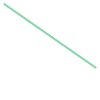

In [42]:
test_route

In [44]:
test_route = gpd.GeoSeries(test_route)

In [45]:
with open('test_route.geojson' , 'w') as file:
    file.write(test_route.to_json())

LineString
LINESTRING (0.0551667 50.2723333, 0.0685 50.2415, 0.2020476 50.2698363, 0.3355952 50.2981557, 0.4691428 50.3264582, 0.6026905 50.3547439, 0.7362381 50.3830128, 0.8697857 50.4112648, 1.0033333 50.4395, 1.111 50.5015, 1.1997222 50.5526666, 1.2884445 50.6037777, 1.3771667 50.6548333, 1.37 50.6615, 1.2770833 50.6084648, 1.1841666 50.5553697, 1.09125 50.5022148, 0.9983333 50.449, 0.8635952 50.4238022, 0.7288571 50.3985909, 0.594119 50.3733662, 0.459381 50.3481281, 0.3246429 50.3228766, 0.1899048 50.2976117, 0.0551667 50.2723333)


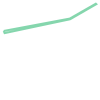

In [353]:
print(test_separation_zone.geom_type)
print(test_separation_zone)
test_separation_zone

LineString
(array('d', [1.3784542999999985, 0.3303207685283604]), array('d', [50.06037359691528, 50.78985235574818]))


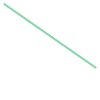

In [354]:
print(test_route.geom_type)
print(test_route.xy)
test_route

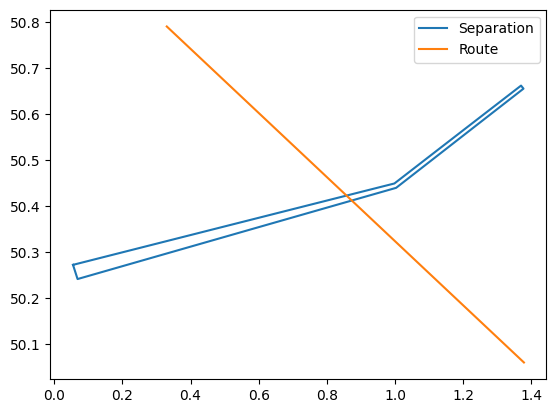

In [355]:
# Extract x and y coordinates from LineString 1
line1_x, line1_y = test_separation_zone.xy

# Extract x and y coordinates from LineString 2
line2_x, line2_y = test_route.xy

# Create a new figure and axes
fig, ax = plt.subplots()

# Plot LineString 1
ax.plot(line1_x, line1_y, label='Separation')

# Plot LineString 2
ax.plot(line2_x, line2_y, label='Route')

# Add legend
ax.legend()

# Show the plot
plt.show()

In [356]:
#Summary of using different spatial predicates 
print('intersects method ->',test_route.intersects(test_separation_zone))
print('overlaps method ->',test_route.overlaps(test_separation_zone))
print('touches method ->',test_route.touches(test_separation_zone))
print('crosses method ->',test_route.crosses(test_separation_zone))


intersects method -> True
overlaps method -> False
touches method -> False
crosses method -> True


### Test2 - DOES NOT INTERCEPT

In [357]:
import matplotlib.pyplot as plt
from shapely.geometry import linestring

In [358]:
#visualize all harbour in specific bbox
bbox = [-0.670166,49.475263,1.944580,51.100073]
visualize_map(harbours_bbox(bbox))

In [359]:
#Define origin / destination harbours ids 
id_origin = 221260087
id_destination = 6274182127

In [360]:
gdf = table_list_gdf_ways2
seamark_list = ['separation_zone','separation_line']

gdf_dict = {}
for i in range(0, len(seamark_list)):
    gdf_dict[f'gdf{i}'] = filtered_gdf_seamark(gdf, seamark_list[i])


# Create a map centered on Germany with a zoom level of 6
map = folium.Map(location=[51.1657, 10.4515], zoom_start=6)

# Add OpenSeaMap tiles as a base layer
folium.TileLayer('http://tiles.openseamap.org/seamark/{z}/{x}/{y}.png',
                 name='OpenSeaMap',
                 attr='Map data © OpenSeaMap contributors').add_to(map)


for k, v in  gdf_dict.items():
    #Add geodataframe to the map 
    folium.GeoJson(v,popup=folium.GeoJsonPopup(fields=list(v.columns[:-1])), 
                   style_function=lambda feature: {'fillColor': '#a60717','color': '#a60717'}).add_to(map)

#for this function the data should be in lat long format, different from normal matplotlib (x,y) = (long, lat)
folium.PolyLine(get_harbours_origin_destination(bbox, id_origin, id_destination)[1],weight=2.5, color='red').add_to(map)
    
# Display the map
map

In [361]:
#filtering specific zone to use as refeence (filter by specific id)
test_separation_zone = LineString(table_list_gdf_ways2[table_list_gdf_ways2['id'] == 129922894]['geom'].iloc[0])

#create a linestring object from the route between the harbours
test_route = LineString(get_harbours_origin_destination(bbox, id_origin, id_destination)[0])

LineString


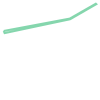

In [362]:
print(test_separation_zone.geom_type)
test_separation_zone

LineString


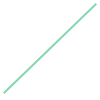

In [363]:
print(test_route.geom_type)
test_route

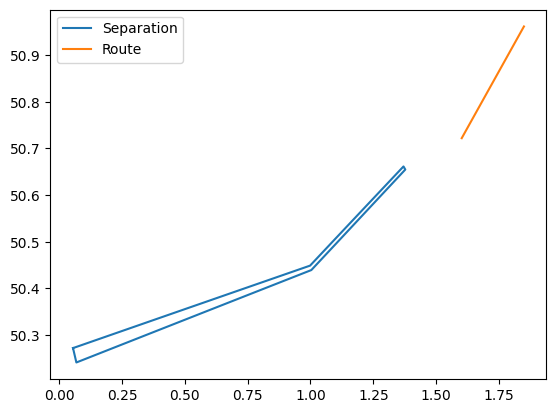

In [364]:
# Extract x and y coordinates from LineString 1
line1_x, line1_y = test_separation_zone.xy

# Extract x and y coordinates from LineString 2
line2_x, line2_y = test_route.xy

# Create a new figure and axes
fig, ax = plt.subplots()

# Plot LineString 1
ax.plot(line1_x, line1_y, label='Separation')

# Plot LineString 2
ax.plot(line2_x, line2_y, label='Route')

# Add legend
ax.legend()

# Show the plot
plt.show()

In [365]:
#Summary of using different spatial predicates 
print('intersects method ->',test_route.intersects(test_separation_zone))
print('overlaps method ->',test_route.overlaps(test_separation_zone))
print('touches method ->',test_route.touches(test_separation_zone))
print('crosses method ->',test_route.crosses(test_separation_zone))


intersects method -> False
overlaps method -> False
touches method -> False
crosses method -> False
